In this notebook we compare the performance of the different domain finder algorithms, applied to the mouse brain ROI in 7.1, to the manually annotated region

In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn.metrics as sk
import os
import json
from shapely.geometry import Point, Polygon
import random
import matplotlib
from xb.plotting import generate_hex_colors
from xb.calculating import compute_nmi,entropy,compute_vi,compute_fmi

In [80]:
saving_path=r'../../data/processed_adata/'
adata=sc.read('../../data/processed_adata/adata_multisection_nuclei_r1_with_annotations.h5ad')
adata=adata[adata.obs['replicate']=='1']
adata.X=adata.layers['raw']
adata.obsm['spatial']=np.array(adata.obs.loc[:,['x_centroid','y_centroid']])

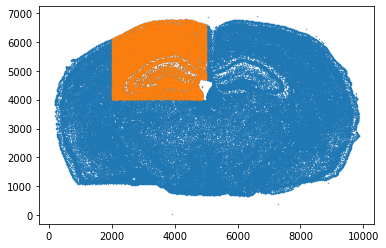

In [81]:

adata2=adata[(adata.obs['x_centroid']<5000)&(adata.obs['x_centroid']>2000)&(adata.obs['y_centroid']>4000)]
plt.scatter(adata.obs.loc[:,'x_centroid'],adata.obs.loc[:,'y_centroid'],s=0.1)
plt.scatter(adata2.obs.loc[:,'x_centroid'],adata2.obs.loc[:,'y_centroid'],s=0.1)
adata=adata2
ndoms=[]
for num in range(1,5):
    ndoms.append(len(np.unique(adata.obs['region_level'+str(num)])))

In [82]:
adatar1=adata

In [84]:
regdict={'6':'region_level1','9':'region_level2','17':'region_level3','49':'region_level4'}
opts=['6','9','17','49']

In [104]:
### READ BORDERS AND GENERATE PALETTE
ob=open('/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/figures/2.comparison_between_datasets/polygons/regions_multisection_1.json')
js=json.load(ob)
output=pd.DataFrame(columns=['y','x','region_annotation','region_general'])
nu=0
for ob in js:
    for num in range(0,len(ob['coordinates'][0])):
        output.loc[nu,:]=list([ob['coordinates'][0][num][0],ob['coordinates'][0][num][1],ob['name'],ob['name'].replace(' [1]','').replace('D: ','')])
        nu=nu+1      
dictio_region=dict(zip(output['region_annotation'],output['region_general']))
dictio_region['D: vl [2]']='vl'
# Example usage:
colors = generate_hex_colors()

0


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


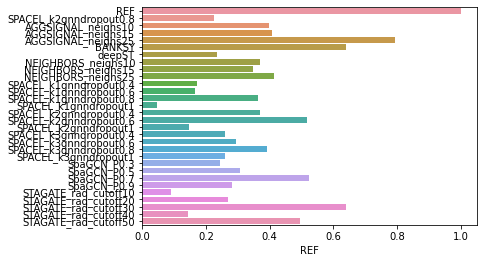

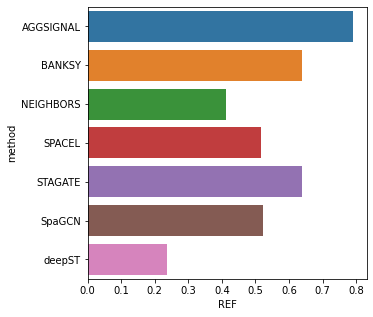

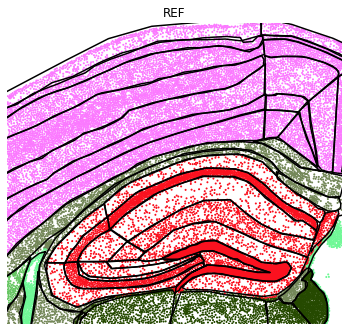

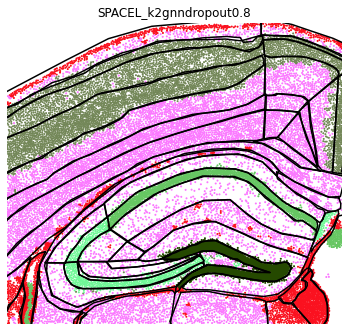

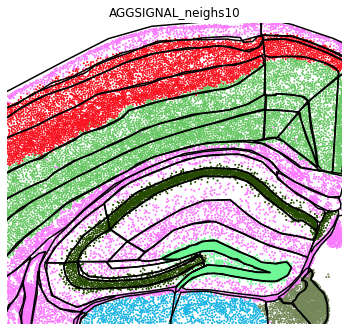

...

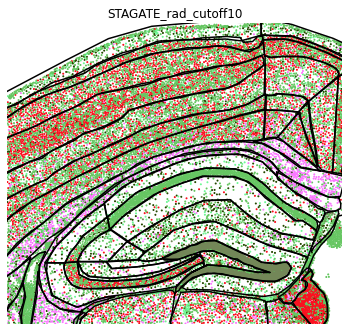

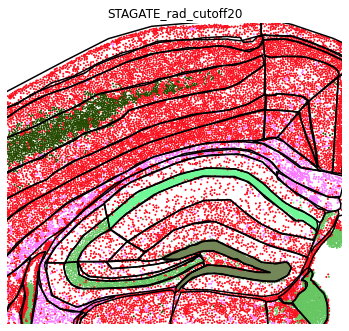

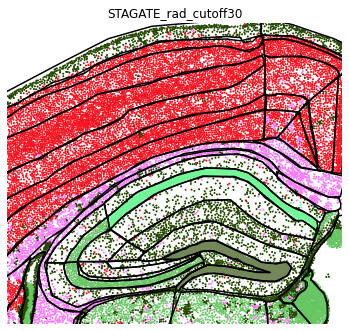

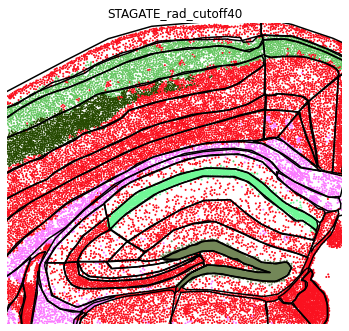

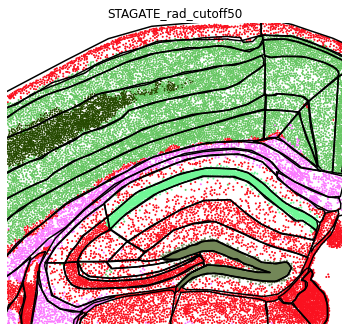

1


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


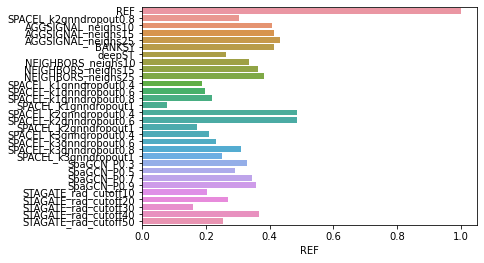

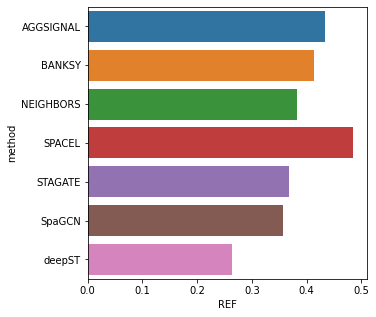

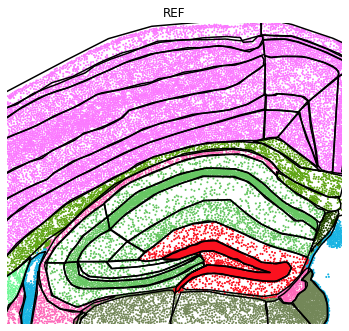

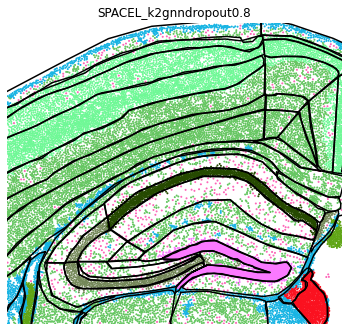

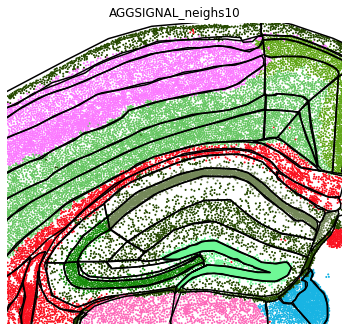

...

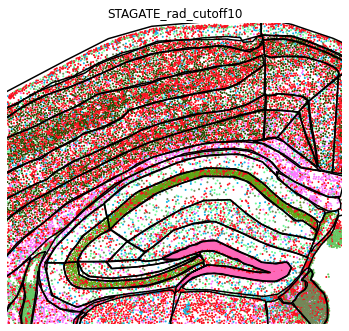

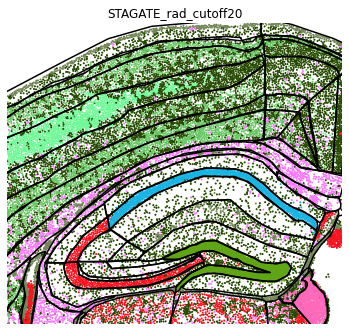

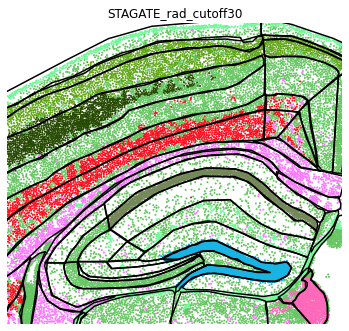

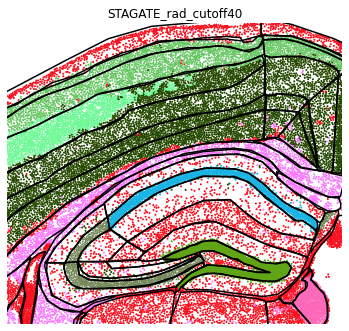

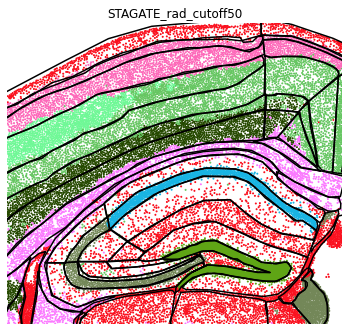

2


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


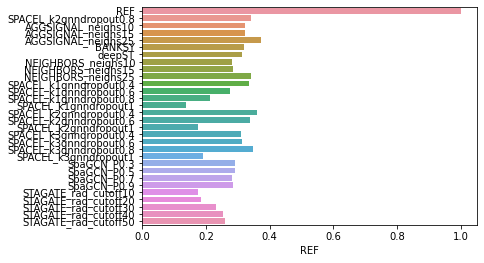

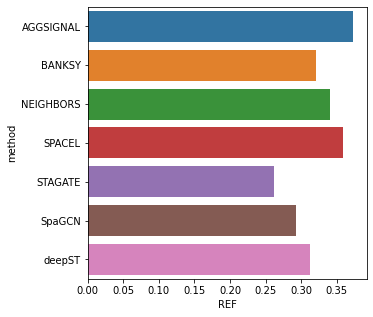

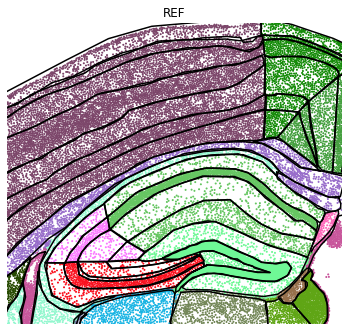

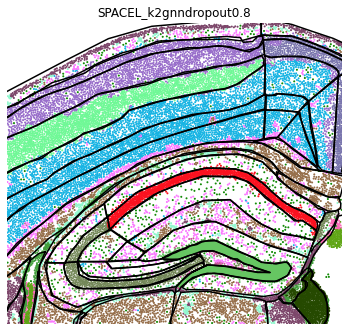

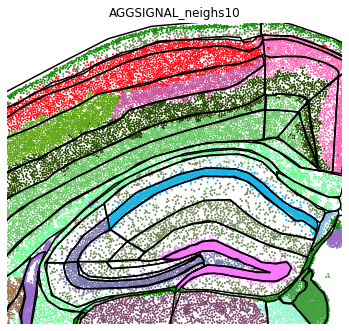

...

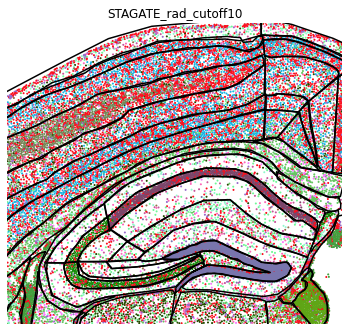

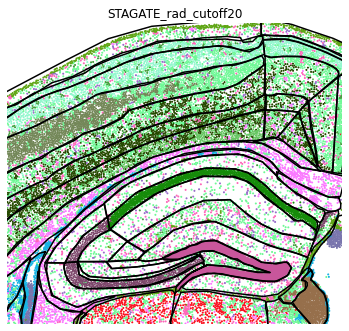

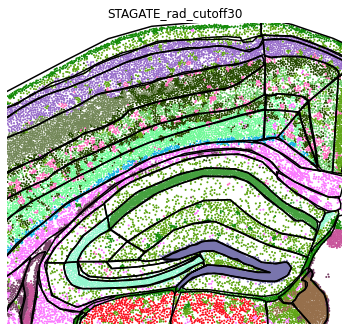

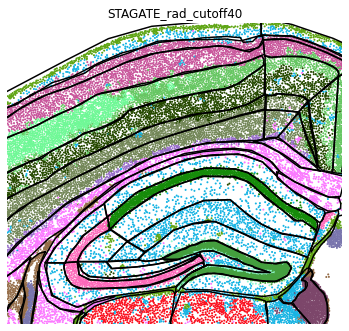

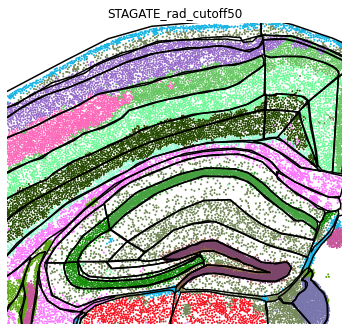

3


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


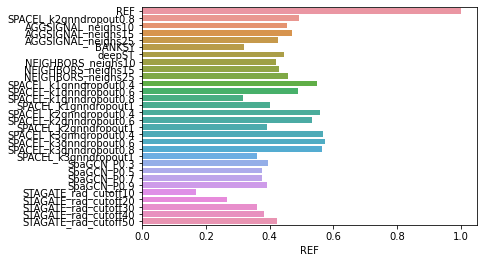

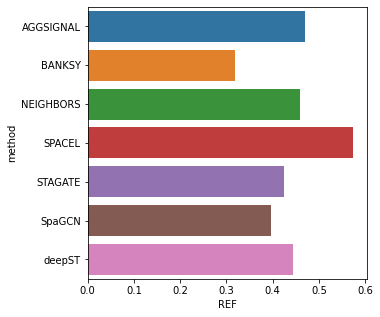

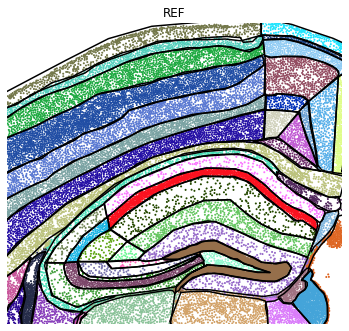

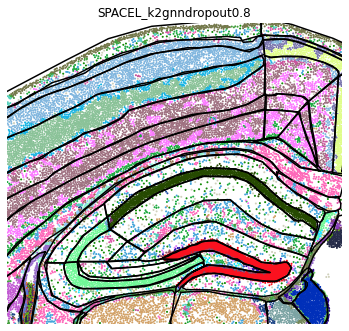

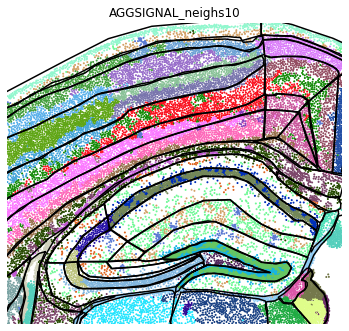

...

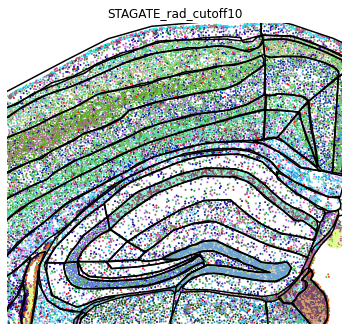

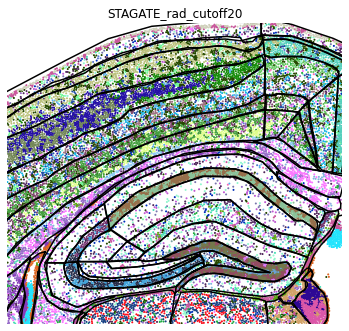

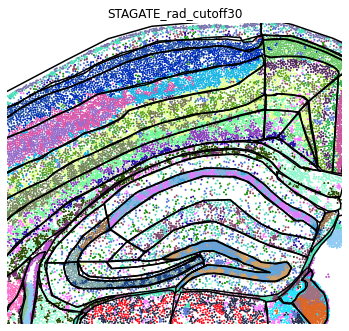

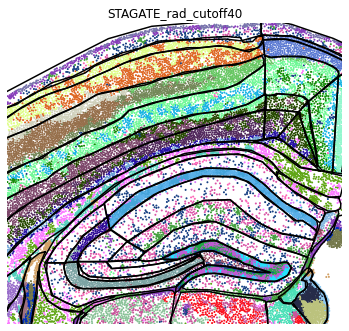

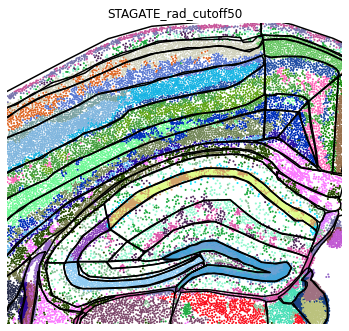

In [191]:
maxscores=[]
for i in range(0,len(opts)):

        print(i)
        path='../../figures/7.spatial_architecture/domains_predicted/ROI1/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=sk.adjusted_rand_score(results[ind],results[col])
        
        import matplotlib
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/ari_between_domain_tools_barplot_'+str(opts[i])+'_ALL.pdf')
        
        import matplotlib
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        ARI_topperf=ARI_with_main.groupby('method').max()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/ari_between_domain_tools_barplot_'+str(opts[i])+'_MAX.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)
        ##
        for num in range(0,results.shape[1]):
            usedclust=results.iloc[:,num]
            uniquecls=np.unique(usedclust)
            coldict=dict(zip(np.unique(uniquecls),colors))

            dim1=(np.max(adata.obs['x_centroid'])-np.min(adata.obs['x_centroid']))/500
            dim2=(np.max(adata.obs['y_centroid'])-np.min(adata.obs['y_centroid']))/500
            plt.figure(figsize=(dim1,dim2))
            plt.scatter(x=adata.obs['x_centroid'],y=adata.obs['y_centroid'],s=1,c=usedclust.map(coldict))
            plsin=output
            plsin['yc']=plsin['x']*0.2125
            plsin['xc']=plsin['y']*0.2125
            from shapely.geometry import Point, Polygon
            for sel in plsin['region_annotation'].unique():
                    plsub=plsin[plsin['region_annotation']==sel]
                    if plsub.shape[0]>2:
                #        plt.figure()
                        coord = np.array(plsub[['yc','xc']]).tolist()
                        coord.append(coord[0])
                        poli=Polygon(coord)
                        xs, ys = zip(*coord) #create lists of x and y values
                        plt.plot(xs,ys,color='black') 
            plt.xlim(np.min(adata.obs['x_centroid']),np.max(adata.obs['x_centroid']))
            plt.ylim(np.min(adata.obs['y_centroid']),np.max(adata.obs['y_centroid']))
            plt.axis('off')
            plt.title(results.columns[num])
            plt.savefig('../../figures/7.spatial_architecture/domains/spatial_maps/'+str(results.columns[num])+'_'+str(opts[i])+'.png') 
        plt.show() # if you need...

# 

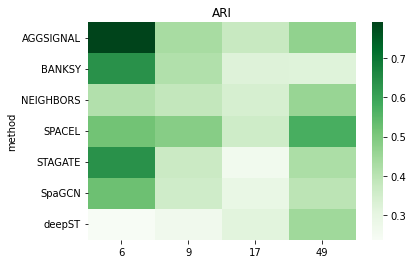

In [192]:
allscores_ARI=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_ARI,cmap='Greens')
plt.title('ARI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_ARI_ROI1.pdf')

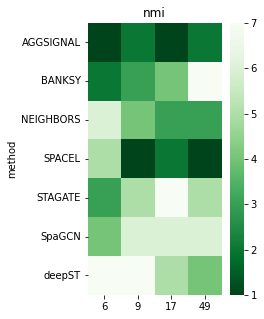

In [193]:
allscores_ARI_ranked=allscores_ARI.rank(axis=0,ascending=False)
plt.figure(figsize=(3,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_ARI_ranked,cmap=matplotlib.cm.get_cmap('Greens_r'))
plt.title('nmi')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_ARI_ROI1_ranked.pdf')

# NMI

0
1
2
3


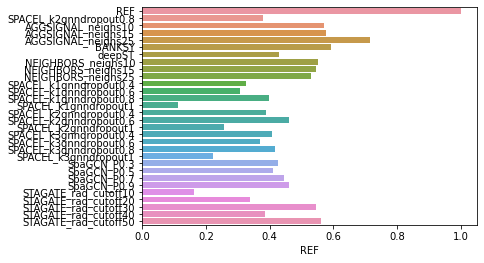

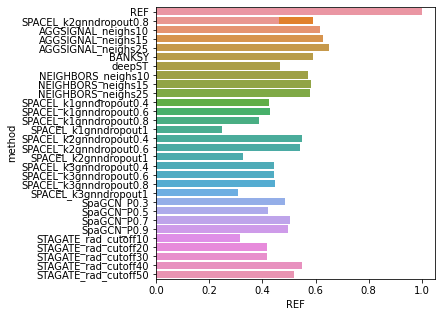

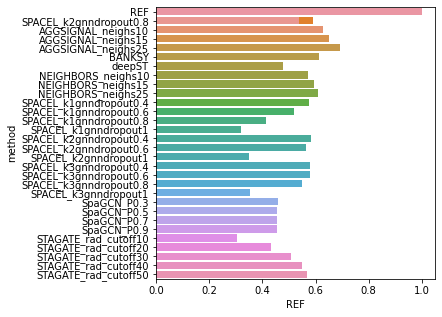

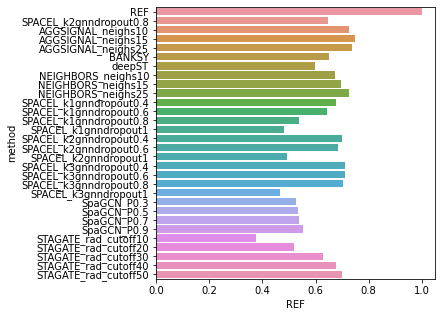

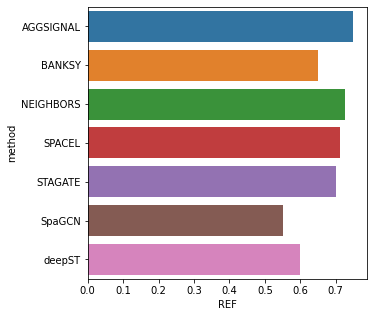

In [188]:
maxscores=[]
for i in range(0,len(opts)):
        print(i)
        path='../../figures/7.spatial_architecture/domains_predicted/ROI1/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=compute_nmi(results[ind],results[col])
        
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/nmi_between_domain_tools_barplot_'+str(opts[i])+'_ALL.pdf')
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        ARI_topperf=ARI_with_main.groupby('method').max()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/nmi_between_domain_tools_barplot_'+str(opts[i])+'_MAX.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)

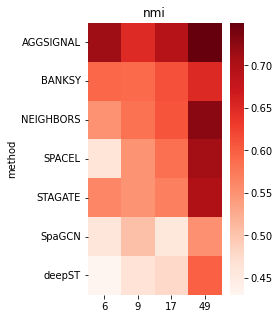

In [189]:
plt.figure(figsize=(3,5))
allscores_nmi=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_nmi,cmap='Reds')
plt.title('nmi')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_NMI_ROI1.pdf')

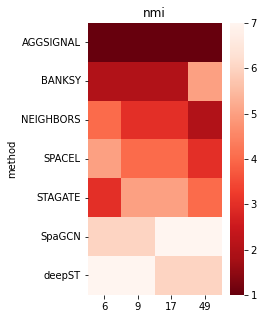

In [190]:
allscores_nmi_ranked=allscores_nmi.rank(axis=0,ascending=False)
plt.figure(figsize=(3,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_nmi_ranked,cmap=matplotlib.cm.get_cmap('Reds_r'))
plt.title('nmi')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_NMI_ROI1_ranked.pdf')

# VI

0
1
2
3


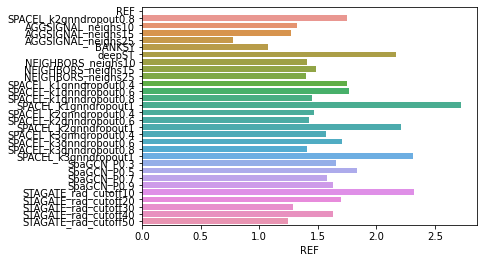

<Figure size 360x360 with 0 Axes>

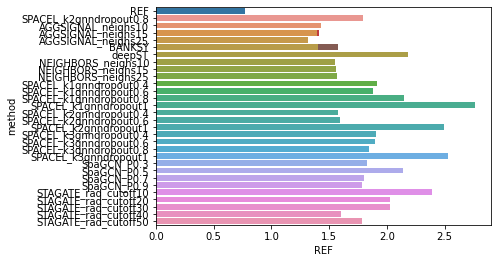

<Figure size 360x360 with 0 Axes>

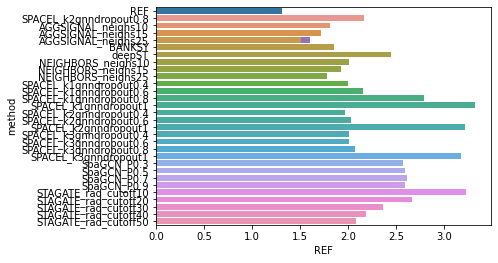

<Figure size 360x360 with 0 Axes>

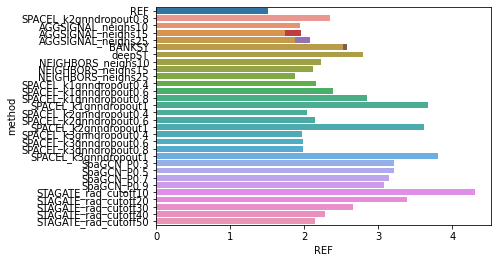

<Figure size 360x360 with 0 Axes>

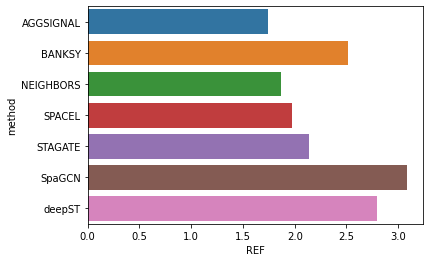

In [185]:
maxscores=[]
for i in range(0,len(opts)):
        print(i)
        path='../../figures/7.spatial_architecture/domains_predicted/ROI1/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=compute_vi(results[ind],results[col])
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/VI_between_domain_tools_barplot_'+str(opts[i])+'_ALL.pdf')
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        plt.figure()
        ARI_topperf=ARI_with_main.groupby('method').min()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/VI_between_domain_tools_barplot_'+str(opts[i])+'_MAX.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)

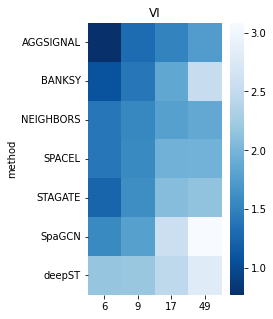

In [186]:
plt.figure(figsize=(3,5))
allscores_VI=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_VI,cmap=matplotlib.cm.get_cmap('Blues_r'))
plt.title('VI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_VI_ROI1.pdf')

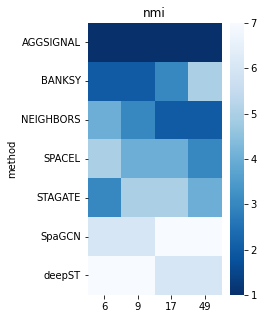

In [187]:
allscores_VI_ranked=allscores_VI.rank(axis=0,ascending=True)
plt.figure(figsize=(3,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_VI_ranked,cmap=matplotlib.cm.get_cmap('Blues_r'))
plt.title('nmi')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_VI_ROI1_ranked.pdf')

# FMI 

0
1
2
3


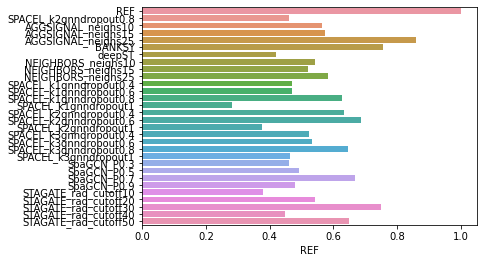

<Figure size 360x360 with 0 Axes>

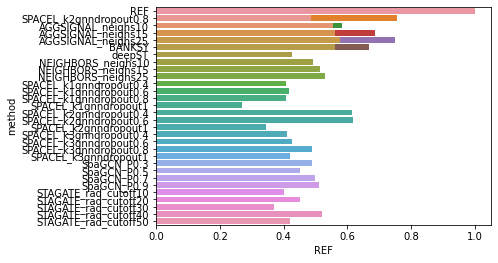

<Figure size 360x360 with 0 Axes>

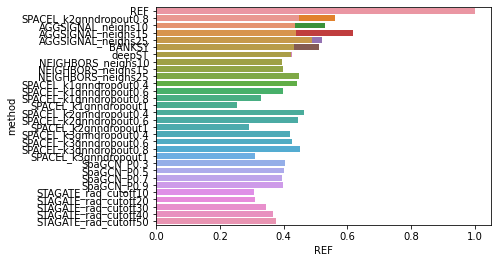

<Figure size 360x360 with 0 Axes>

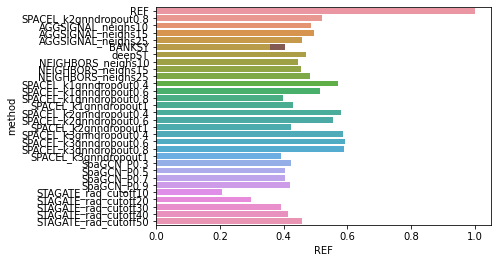

<Figure size 360x360 with 0 Axes>

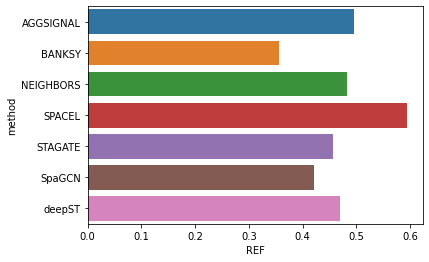

In [182]:
maxscores=[]
for i in range(0,len(opts)):
        print(i)
        path='../../figures/7.spatial_architecture/domains_predicted/ROI1/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=compute_fmi(results[ind],results[col])
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/fmi_between_domain_tools_barplot_'+str(opts[i])+'_ALL.pdf')
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        plt.figure()
        ARI_topperf=ARI_with_main.groupby('method').max()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/fmi_between_domain_tools_barplot_'+str(opts[i])+'_MAX.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)

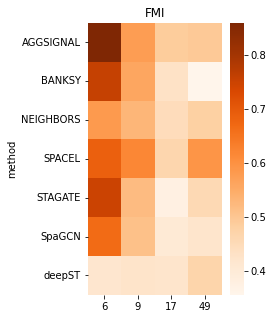

In [183]:
plt.figure(figsize=(3,5))
allscores_FMI=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_FMI,cmap=matplotlib.cm.get_cmap('Oranges'))
plt.title('FMI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_FMI_ROI1.pdf')

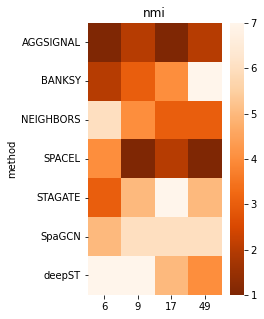

In [184]:
allscores_FMI_ranked=allscores_FMI.rank(axis=0,ascending=False)
plt.figure(figsize=(3,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_FMI_ranked,cmap=matplotlib.cm.get_cmap('Oranges_r'))
plt.title('nmi')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_FMI_ROI1_ranked.pdf')

# aggreg

In [ ]:
maxscores=[]
for i in range(0,len(opts)):
        print(i)
        path='../../figures/7.spatial_architecture/domains_predicted/ROI1/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=compute_vi(results[ind],results[col])
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/VI_between_domain_tools_barplot_'+str(opts[i])+'_ALL.pdf')
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        plt.figure()
        ARI_topperf=ARI_with_main.groupby('method').min()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/VI_between_domain_tools_barplot_'+str(opts[i])+'_MAX.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)

In [125]:
allscores_ARI=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_ARI,cmap='Greens')
plt.title('ARI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_ARI_ROI1.pdf')

<AxesSubplot:>

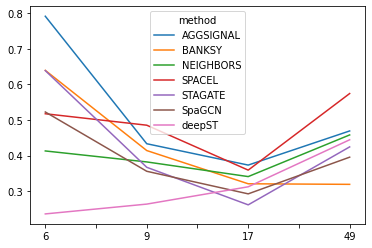

In [128]:
allscores_ARI.transpose().plot()